In [205]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import folium
import json
import seaborn as sns
from sklearn.cluster import KMeans
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
import json
from geopy.geocoders import Nominatim
import requests
from pandas.io.json import json_normalize 
import matplotlib.cm as cm
import matplotlib.colors as colors
import folium
print("Imported necessary dependencies.")
import geocoder
import os
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

Imported necessary dependencies.


### Loadign the census data for Toronto

In [206]:
df=pd.read_csv("../Downloads/toronto.csv",thousands=',',encoding='utf-8')
df.shape

(2314, 146)

### Dropping irrelevant columns

In [207]:
df.drop(['_id','Data Source'],axis=1,inplace=True)
df.head()

,Category,Topic,Characteristic,City of Toronto,Agincourt North,Agincourt South-Malvern West,Alderwood,Annex,Banbury-Don Mills,Bathurst Manor,Bay Street Corridor,Bayview Village,Bayview Woods-Steeles,Bedford Park-Nortown,Beechborough-Greenbrook,Bendale,Birchcliffe-Cliffside,Black Creek,Blake-Jones,Briar Hill-Belgravia,Bridle Path-Sunnybrook-York Mills,Broadview North,Brookhaven-Amesbury,Cabbagetown-South St. James Town,Caledonia-Fairbank,Casa Loma,Centennial Scarborough,Church-Yonge Corridor,Clairlea-Birchmount,Clanton Park,Cliffcrest,Corso Italia-Davenport,Danforth,Danforth East York,Don Valley Village,Dorset Park,Dovercourt-Wallace Emerson-Junction,Downsview-Roding-CFB,Dufferin Grove,East End-Danforth,Edenbridge-Humber Valley,Eglinton East,Elms-Old Rexdale,Englemount-Lawrence,Eringate-Centennial-West Deane,Etobicoke West Mall,Flemingdon Park,Forest Hill North,Forest Hill South,Glenfield-Jane Heights,Greenwood-Coxwell,Guildwood,Henry Farm,High Park North,High Park-Swansea,Highland Creek,Hillcrest Village,Humber Heights-Westmount,Humber Summit,Humbermede,Humewood-Cedarvale,Ionview,Islington-City Centre West,Junction Area,Keelesdale-Eglinton West,Kennedy Park,Kensington-Chinatown,Kingsview Village-The Westway,Kingsway South,Lambton Baby Point,L'Amoreaux,Lansing-Westgate,Lawrence Park North,Lawrence Park South,Leaside-Bennington,Little Portugal,Long Branch,Malvern,Maple Leaf,Markland Wood,Milliken,Mimico (includes Humber Bay Shores),Morningside,Moss Park,Mount Dennis,Mount Olive-Silverstone-Jamestown,Mount Pleasant East,Mount Pleasant West,New Toronto,Newtonbrook East,Newtonbrook West,Niagara,North Riverdale,North St. James Town,Oakridge,Oakwood Village,O'Connor-Parkview,Old East York,Palmerston-Little Italy,Parkwoods-Donalda,Pelmo Park-Humberlea,Playter Estates-Danforth,Pleasant View,Princess-Rosethorn,Regent Park,Rexdale-Kipling,Rockcliffe-Smythe,Roncesvalles,Rosedale-Moore Park,Rouge,Runnymede-Bloor West Village,Rustic,Scarborough Village,South Parkdale,South Riverdale,St.Andrew-Windfields,Steeles,Stonegate-Queensway,Tam O'Shanter-Sullivan,Taylor-Massey,The Beaches,Thistletown-Beaumond Heights,Thorncliffe Park,Trinity-Bellwoods,University,Victoria Village,Waterfront Communities-The Island,West Hill,West Humber-Clairville,Westminster-Branson,Weston,Weston-Pelham Park,Wexford/Maryvale,Willowdale East,Willowdale West,Willowridge-Martingrove-Richview,Woburn,Woodbine Corridor,Woodbine-Lumsden,Wychwood,Yonge-Eglinton,Yonge-St.Clair,York University Heights,Yorkdale-Glen Park
0,Neighbourhood Information,Neighbourhood Information,Neighbourhood Number,NaN,129,128,20,95,42,34,76,52,49,39,112,127,122,24,69,108,41,57,30,71,109,96,133,75,120,33,123,92,66,59,47,126,93,26,83,62,9,138,5,32,11,13,44,102,101,25,65,140,53,88,87,134,48,8,21,22,106,125,14,90,110,124,78,6,15,114,117,38,105,103,56,84,19,132,29,12,130,17,135,73,115,2,99,104,18,50,36,82,68,74,121,107,54,58,80,45,23,67,46,10,72,4,111,86,98,131,89,28,139,85,70,40,116,16,118,61,63,3,55,81,79,43,77,136,1,35,113,91,119,51,37,7,137,64,60,94,100,97,27,31
1,Neighbourhood Information,Neighbourhood Information,TSNS2020 Designation,NaN,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,NIA,No Designation,No Designation,NIA,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,Emerging Neighbourhood,No Designation,NIA,No Designation,No Designation,No Designation,NIA,NIA,Emerging Neighbourhood,No Designation,No Designation,NIA,No Designation,No Designation,NIA,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,No Designation,Emerging Neighbourhood,NIA,NIA,No Designation,NIA,No Designation,No Designation,NIA,NIA,No Designation,NIA,No Designation,No Designation,Emergi

### transpose dataframe and drop the first 3 rows that are not relevant

In [208]:
population=df.copy()
population=population.transpose()
#.reset_index(drop=True)
population.rename(columns=population.iloc[2],inplace=True)
#population.drop("TSNS2020 Designation",axis=1,inplace=True)
population=population.iloc[4:]
population.dropna(how='all', axis=1,inplace=True)
population=population.rename(columns=lambda x: x.strip())
#save to a new file
population.drop(['Neighbourhood Number','TSNS2020 Designation'],axis=1,inplace=True)
population.to_csv("population.csv")
population.shape

(140, 2257)

### tranforming cell values by removing $,% and other signs from numerical values 

In [209]:
#loading again from the file 
population=pd.read_csv("population.csv")
columns=population.columns
neighborhoods=population.iloc[:,0]
population=population.loc[:,~population.columns.str.contains("^Unnamed")]
#.rename(columns={population.iloc[0]:'Neighborhood'},inplace=True)
#population.drop(['Population, 2011','Private dwellings occupied by usual residents','Land area in square kilometres'],inplace=True,axis=1)
i=0
# removing extra characters from numbers like $,% etc
for col in population:
    if i>-1:
        population[col] = population[col].astype('str')
        population[col] = population[col].str.replace(',', '')
        population[col] = population[col].str.replace('$', '')
        population[col] = population[col].str.replace('%','').astype("float")
    else:
        i=i+1
#mask = np.triu(np.ones_like(population.corr(), dtype=np.bool))

# Set up the matplotlib figure
#f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
#cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
#sns.heatmap(population.corr(), mask=mask, cmap=cmap, vmax=.3, center=0,
#            square=True, linewidths=.5, cbar_kws={"shrink": .5})

#population.insert(0, 'Neighborhood', neighborhoods)
population

Population, 2016  Population, 2011  Population Change 2011-2016  \
0             29113.0           30279.0                         -3.9   
1             23757.0           21988.0                          8.0   
2             12054.0           11904.0                          1.3   
3             30526.0           29177.0                          4.6   
4             27695.0           26918.0                          2.9   
5             15873.0           15434.0                          2.8   
6             25797.0           19348.0                         33.3   
7             21396.0           17671.0                         21.1   
8             13154.0           13530.0                         -2.8   
9             23236.0           23185.0                          0.2   
10             6577.0            6488.0                          1.4   
11            29960.0           27876.0                          7.5   
12            22291.0           21856.0                          2.0   
13            21737.0           22057.0                         -1.5   
14             7727.0            7763.0                         -0.5   
15            14257.0           14302.0                         -0.3   
16             9266.0            8713.0                          6.3   
17            11499.0           11563.0                         -0.6   
18            17757.0           17787.0                         -0.2   
19            11669.0           12053.0                         -3.2   
20             9955.0            9851.0                          1.1   
21            10968.0           10487.0                          4.6   
22            13362.0           13093.0                          2.1   
23            31340.0           28349.0                         10.6   
24            26984.0           24770.0                          8.9   
25            16472.0           14612.0                         12.7   
26            15935.0           15703.0                          1.5   
27            14133.0           13743.0                          2.8   
28             9666.0            9444.0                          2.4   
29            17180.0           16712.0                          2.8   
30            27051.0           26739.0                          1.2   
31            25003.0           24363.0                          2.6   
32            36625.0           34631.0                          5.8   
33            35052.0           34659.0                          1.1   
34            11785.0           11449.0                          2.9   
35            21381.0           20839.0                          2.6   
36            15535.0           14943.0                          4.0   
37            22776.0           22829.0                         -0.2   
38             9456.0            9550.0                         -1.0   
39            22372.0           22086.0                          1.3   
40            18588.0           18810.0                         -1.2   
41            11848.0           10927.0                          8.4   
42            21933.0           22168.0                         -1.1   
43            12806.0           12474.0                          2.7   
44            10732.0           10926.0                         -1.8   
45            30491.0           31390.0                         -2.9   
46            14417.0           14083.0                          2.4   
47             9917.0            9816.0                          1.0   
48            15723.0           11333.0                         38.7   
49            22162.0           21292.0                          4.1   
50            23925.0           21740.0                         10.1   
51            12494.0           13097.0                         -4.6   
52            16934.0           17656.0                         -4.1   
53            10948.0           10583.0                          3.4   
54            12416.0           12525.0      

### Principal Component Analysis

Here, I standardize data by scaling using StandardScaler() and feed into PCA() to obtain principal components.

array([[ 0.96039964,  1.27918551, -0.89510548, ..., -0.21387966,
        -0.37674043,  0.50360416],
       [ 0.42467593,  0.36489869,  0.44630473, ..., -0.19434472,
        -0.19005664,  0.42785202],
       [-0.74589439, -0.7471105 , -0.30894304, ..., -0.30764735,
        -0.51949861, -0.89781043],
       ...,
       [-0.69848344, -0.7748997 ,  0.38994296, ...,  0.01272562,
         0.04055274, -0.4088648 ],
       [ 0.80836453,  0.99622085, -0.50057306, ...,  0.37607545,
        -0.24496364,  1.19570327],
       [-0.47083087, -0.44021625, -0.36530481, ..., -0.44048493,
        -0.37674043, -0.53282285]])

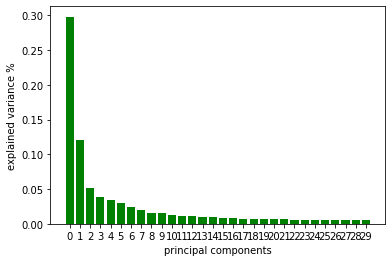

In [210]:
scaled_pop = StandardScaler().fit_transform(population)
pca = PCA(n_components=30)
pca_ = pca.fit_transform(scaled_pop)
features = range(pca.n_components_)
plt.bar(features, pca.explained_variance_ratio_, color='green')
plt.xlabel('principal components')
plt.ylabel('explained variance %')
plt.xticks(features)
PCA_components = pd.DataFrame(pca_)
scaled_pop

Text(0, 0.5, 'PCA 2')

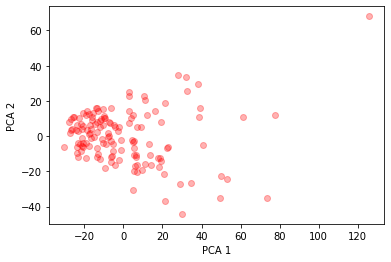

In [211]:
plt.scatter(PCA_components[0], PCA_components[1], alpha=.3, color='red')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')

### Elblow plot

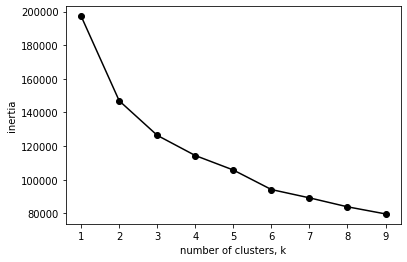

In [212]:
ks = range(1, 10)
inertias = []
for k in ks:
    # Create a KMeans instance with k clusters: model
    model = KMeans(n_clusters=k)
    
    # Fit model to samples
    model.fit(PCA_components.iloc[:,:19])
    
    # Append the inertia to the list of inertias
    inertias.append(model.inertia_)
    
plt.plot(ks, inertias, '-o', color='black')
plt.xlabel('number of clusters, k')
plt.ylabel('inertia')
plt.xticks(ks)
plt.show()

The above plot doesn't show a clear elbow reflection point.

array([0, 0, 3, 1, 1, 3, 1, 0, 3, 1, 3, 0, 1, 0, 3, 3, 3, 3, 0, 3, 3, 3,
       3, 1, 0, 3, 3, 3, 3, 3, 0, 0, 1, 2, 3, 1, 3, 0, 3, 0, 3, 3, 0, 3,
       3, 2, 3, 3, 0, 1, 1, 3, 3, 3, 3, 0, 3, 3, 2, 3, 3, 0, 3, 0, 3, 3,
       2, 3, 3, 3, 3, 3, 3, 2, 3, 3, 0, 1, 0, 1, 3, 2, 3, 1, 3, 3, 0, 1,
       3, 0, 0, 0, 0, 3, 3, 2, 3, 3, 3, 3, 3, 3, 0, 3, 1, 2, 3, 3, 0, 0,
       1, 3, 0, 1, 0, 0, 1, 3, 0, 3, 3, 0, 4, 0, 2, 2, 0, 3, 0, 2, 3, 0,
       2, 3, 3, 3, 3, 3, 2, 3], dtype=int32)

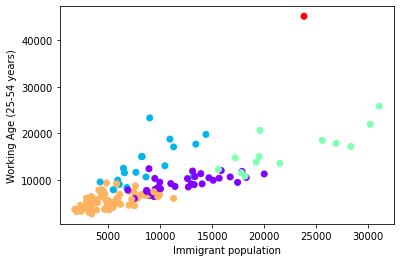

In [213]:
kmeans=KMeans(n_clusters=5).fit(PCA_components.iloc[:,:19])
plt.scatter(population['Immigrants'],population['Working Age (25-54 years)'], c=kmeans.labels_, cmap='rainbow')
plt.xlabel("Immigrant population")
plt.ylabel("Working Age (25-54 years)")
kmeans.labels_

### Adding neighborhood column to the PCA table

In [214]:
pca_pop=PCA_components.copy()
pca_pop.insert(0,'Neighborhood',neighborhoods)
pca_pop

,Neighborhood,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29
0,Agincourt North,14.195666,-16.496482,21.393598,-6.181858,-15.008564,11.895314,-9.720045,1.823575,-4.285150,4.942109,6.905408,-6.332586,-4.293113,1.505846,0.582215,-1.495630,-1.109946,1.042521,1.539590,2.616096,-0.401278,-0.728653,-1.473935,3.356367,1.854928,1.581992,-1.882092,-2.231244,3.271733,-1.923460
1,Agincourt South-Malvern West,5.315811,-10.934342,14.080740,-6.738449,-8.089080,6.963635,-6.387700,1.449728,-4.703788,1.101472,3.222477,-3.247451,-1.238221,1.035217,1.753895,0.490562,-0.421502,2.035983,0.818184,1.925282,0.841567,1.580091,-1.013859,2.940081,1.137363,0.108100,0.223182,-0.714199,1.638323,0.121149
2,Alderwood,-18.836194,3.400189,-1.156001,7.495414,-5.007579,-1.044956,-0.091203,7.580792,-6.685756,-2.522467,-0.864490,-0.026427,1.587933,-1.069427,0.651035,0.413788,0.125943,-1.036228,-0.765585,2.469931,-0.041370,2.540747,-1.716281,1.641050,1.416831,-3.336521,1.767929,0.046147,-1.268410,3.338261
3,Annex,27.978985,34.518883,-5.640093,-0.682788,-4.082035,0.237529,2.464253,-8.651366,9.545216,9.857524,2.234185,1.405833,-7.992868,4.995154,6.778763,5.324941,-2.199376,4.622417,-2.415831,-2.470975,-2.320002,-0.593716,0.915048,-0.801261,-7.240297,-2.868129,-4.590521,-5.022788,-7.154044,-0.905283
4,Banbury-Don Mills,19.474323,7.943708,11.850961,11.274853,-3.288791,-1.766401,6.415023,3.801255,11.968211,3.969446,-1.602556,-4.002151,2.537938,-0.900921,2.006791,1.136694,0.708037,-0.368831,-5.010132,-0.616280,0.674232,4.285958,-0.933976,-0.373786,-4.995101,2.021741,-3.792002,-2.478973,4.995038,-0.196150
5,Bathurst Manor,-7.699496,-0.238035,5.607063,10.347752,9.565174,-0.260962,-1.940452,-6.253300,-1.519788,-1.392154,2.666474,-1.223571,3.455555,0.376134,1.788461,-0.363864,-1.081118,-0.209470,0.195066,1.355787,0.992522,0.936709,-1.561428,-0.047990,0.318271,0.485815,-0.750454,0.694673,-0.567558,-0.699339
6,Bay Street Corridor,21.502090,18.980048,9.088317,-20.687585,14.453940,8.812107,6.019208,1.590279,1.573643,-1.670591,-6.845001,-1.366458,-4.045794,-0.671518,10.108292,12.146788,0.507451,-2.020265,0.289208,2.041343,-0.178399,-9.907491,-9.558706,9.253804,-6.843886,-7.599240,3.036628,10.279944,-6.242473,0.324535
7,Bayview Village,7.157352,4.951980,15.222900,-2.744205,6.197290,6.769620,3.177708,2.688546,1.792174,-3.035014,-5.554094,3.670365,-0.216448,-0.772307,-1.468913,-0.537080,1.963101,-0.020531,0.981793,0.375512,0.569264,-0.469739,-0.703506,-0.688331,-0.874718,0.624786,0.376507,-1.664236,0.559979,0.654856
8,Bayview Woods-Steeles,-14.912967,-0.375712,12.121161,-0.850068,0.285277,4.946013,1.616298,1.710003,0.953273,-0.527342,-2.091429,-0.640355,-0.545481,-0.099738,-0.358335,0.018136,1.417156,-0.449742,-2.333756,-0.656297,-0.320083,0.541553,0.037195,-1.598665,-2.383789,2.056690,-0.322589,-2.788541,-0.286606,0.747765
9,Bedford Park-Nortown,2.828711,14.238012,5.917414,12.525522,-4.885256,-0.825395,10.311568,-16.020200,8.903812,1.591785,1.254412,-4.528201,-7.714439,6.234170,3.768276,-5.718196,-2.504360,-4.535118,2.065086,6.088982,-0.507311,2.108323,0.525944,2.388134,3.067610,3.311196,-0.098118,2.492524,-3.421992,3.228213


### information value of the first 10 columns

In [215]:
print(pd.Series(pca.components_[0][:10]).sort_values(ascending=False))

0    0.041331
9    0.040149
4    0.039491
1    0.039353
3    0.038741
8    0.037861
7    0.031010
6    0.020496
2    0.015158
5    0.004893
dtype: float64


###  Using z-score to separate outliers

Notice I am selecting outliers not from the original data frame but from the PCA_components frame.

In [216]:
# computing z-scores to detect outliers and separate them
from scipy import stats
z_scores = stats.zscore(PCA_components)
abs_z_scores = np.abs(z_scores)
#anything that falls below 3 standard deviations is put in the new_df (normal group)
#the rest go into outliers
filtered_entries = (abs_z_scores < 3).all(axis=1)
population.insert(0,'Neighborhood',neighborhoods)
new_df = population[filtered_entries].reset_index(drop=True)
outliers=population[~filtered_entries].reset_index(drop=True)
outliers_pca=PCA_components[~filtered_entries].reset_index(drop=True)

In [217]:
outliers_pca.shape

(30, 30)

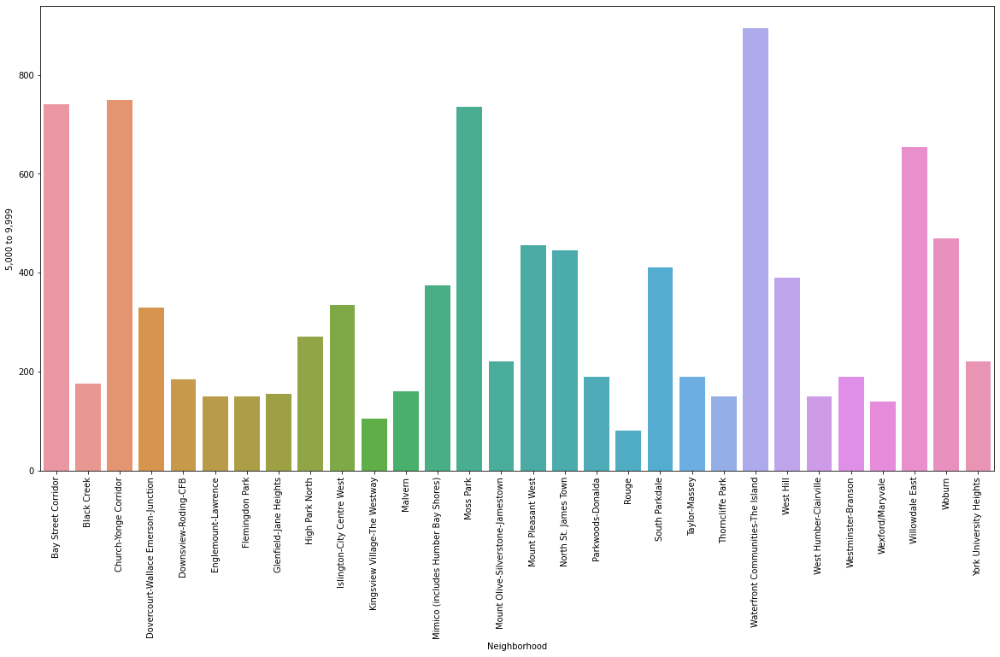

In [218]:
fig, ax = plt.subplots(figsize=(20,10))
plt.xticks(rotation=90)
ax=sns.barplot(x='Neighborhood',y='5,000 to 9,999',data=outliers)

Text(0.5, 1.0, 'Outliers, Average Immigrant Population=15878.0')

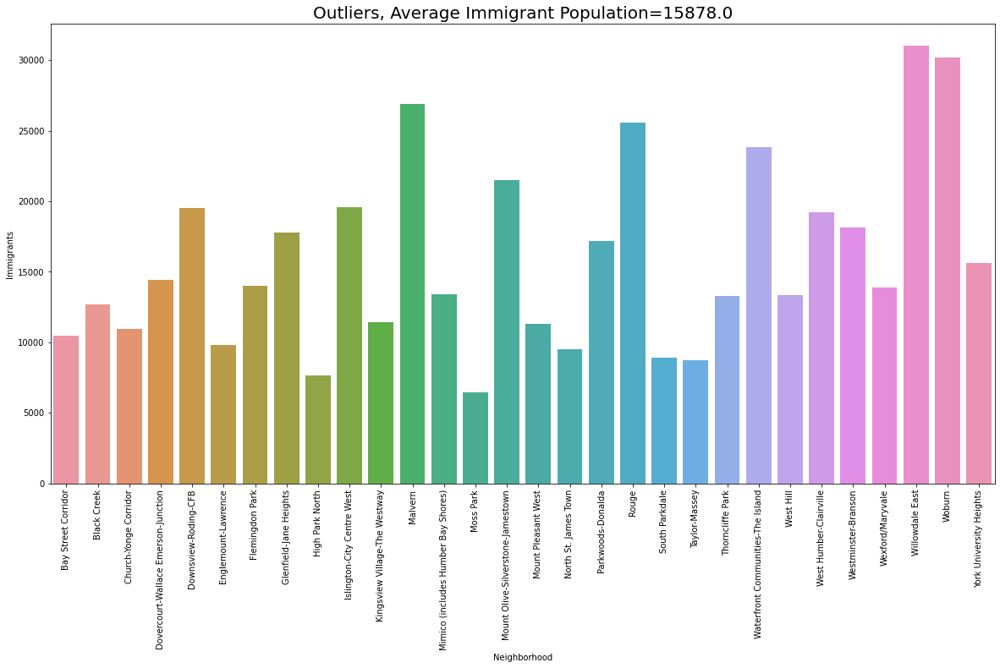

In [219]:
fig, ax = plt.subplots(figsize=(20,10))
plt.xticks(rotation=90)
ax=sns.barplot(x='Neighborhood',y='Immigrants',data=outliers)
ax.set_title("Outliers, Average Immigrant Population="+str(round(outliers['Immigrants'].mean())),fontsize="20")

7178.909090909091

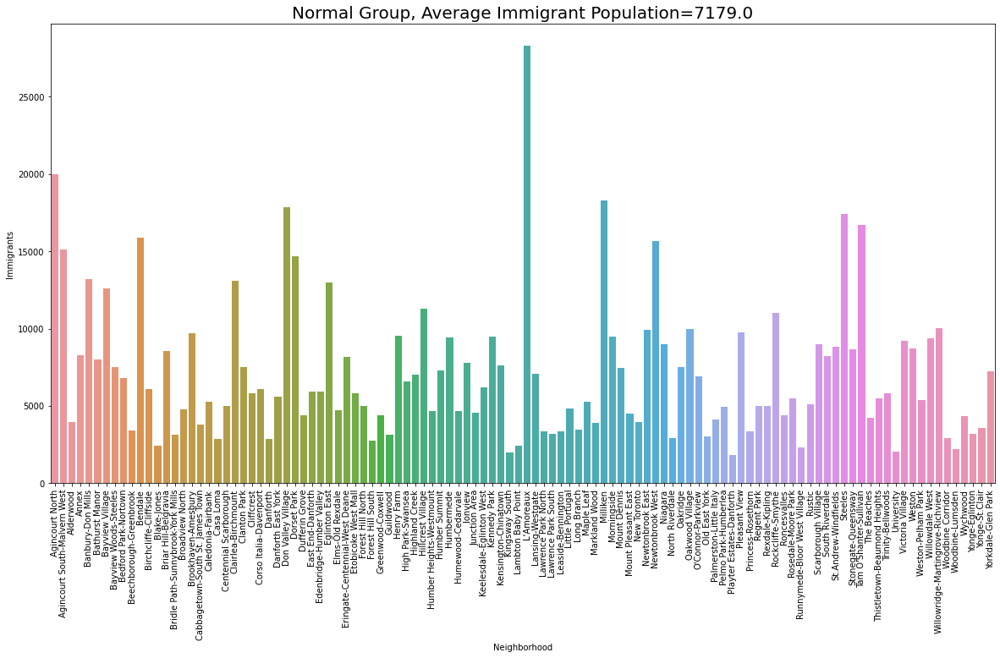

In [220]:
fig, ax = plt.subplots(figsize=(20,10))
plt.xticks(rotation=90)
ax=sns.barplot(x='Neighborhood',y='Immigrants',data=new_df)
ax.set_title("Normal Group, Average Immigrant Population="+str(round(new_df['Immigrants'].mean())),fontsize="20")

new_df['Immigrants'].mean()

In [221]:
def percentify(df):
    df=df.reset_index()
    row_sum=0
    for index,x in df.iterrows():
        for i, row_value in x.iteritems():
            row_sum +=row_value
        for i, row_value in x.iteritems():
            df.at[index,i]=(row_value/row_sum)*100
        row_sum=0
    df.drop(['index'],axis=1,inplace=True)
    return df

### converting values into percentages to draw stack chart

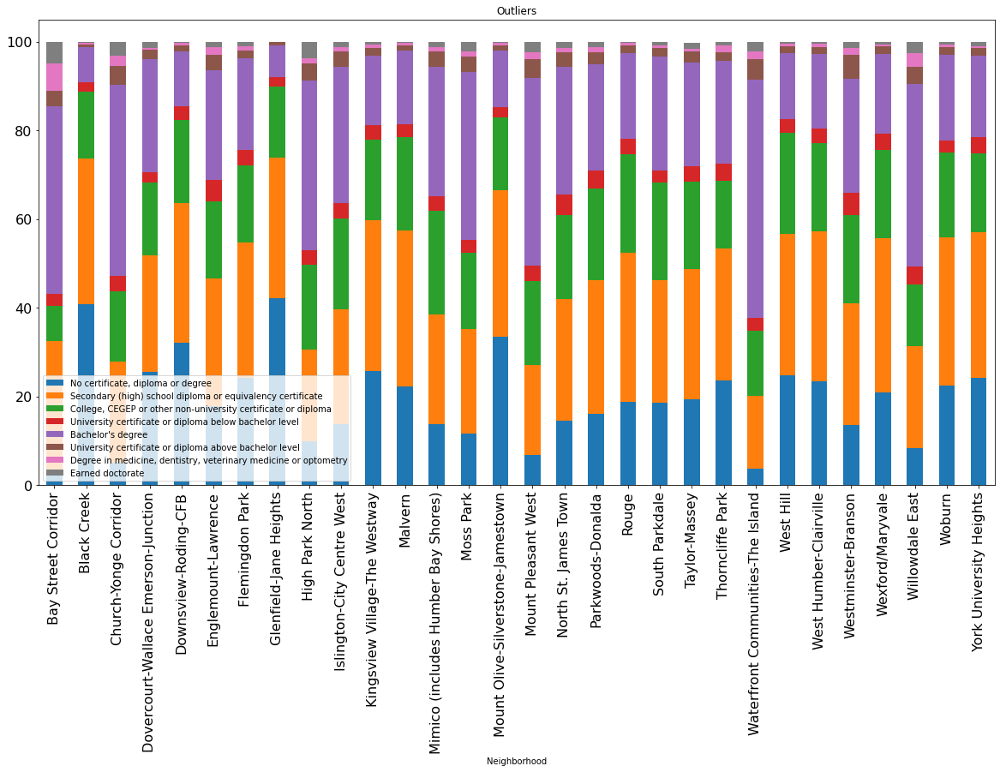

In [222]:
#outliers.reset_index(inplace=True)
df_plot=pd.DataFrame()
df_plot =percentify(outliers[['No certificate, diploma or degree',
       'Secondary (high) school diploma or equivalency certificate',
       'College, CEGEP or other non-university certificate or diploma',
       'University certificate or diploma below bachelor level',
       'Bachelor\'s degree',
       'University certificate or diploma above bachelor level',
       'Degree in medicine, dentistry, veterinary medicine or optometry',
       'Earned doctorate']].copy())
df_plot.insert(0,'Neighborhood',outliers['Neighborhood'])
#df_plot = df_plot.groupby(df_plot.columns.to_list()).size().reset_index().drop([0],axis=1)
df_plot.plot(kind='bar', stacked=True,x='Neighborhood',figsize=(20,10),title="Outliers",fontsize='16',grid=False)
#df_plot

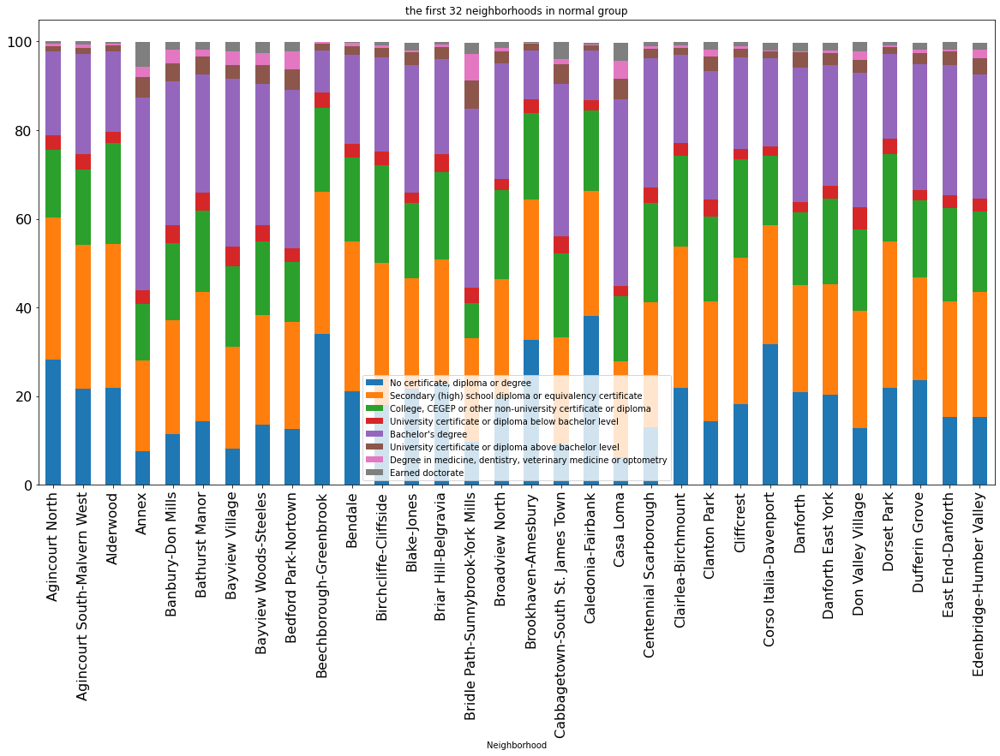

In [223]:
#outliers.reset_index(inplace=True)
df_plot=pd.DataFrame()
df_plot =percentify(new_df[['No certificate, diploma or degree',
       'Secondary (high) school diploma or equivalency certificate',
       'College, CEGEP or other non-university certificate or diploma',
       'University certificate or diploma below bachelor level',
       'Bachelor\'s degree',
       'University certificate or diploma above bachelor level',
       'Degree in medicine, dentistry, veterinary medicine or optometry',
       'Earned doctorate']].copy())
df_plot.insert(0,'Neighborhood',new_df['Neighborhood'])
#df_plot = df_plot.groupby(df_plot.columns.to_list()).size().reset_index().drop([0],axis=1)
df_plot[:32].plot(kind='bar', stacked=True,x='Neighborhood',figsize=(20,10),title="the first 32 neighborhoods in normal group",fontsize='16',grid=False)
#df_plot

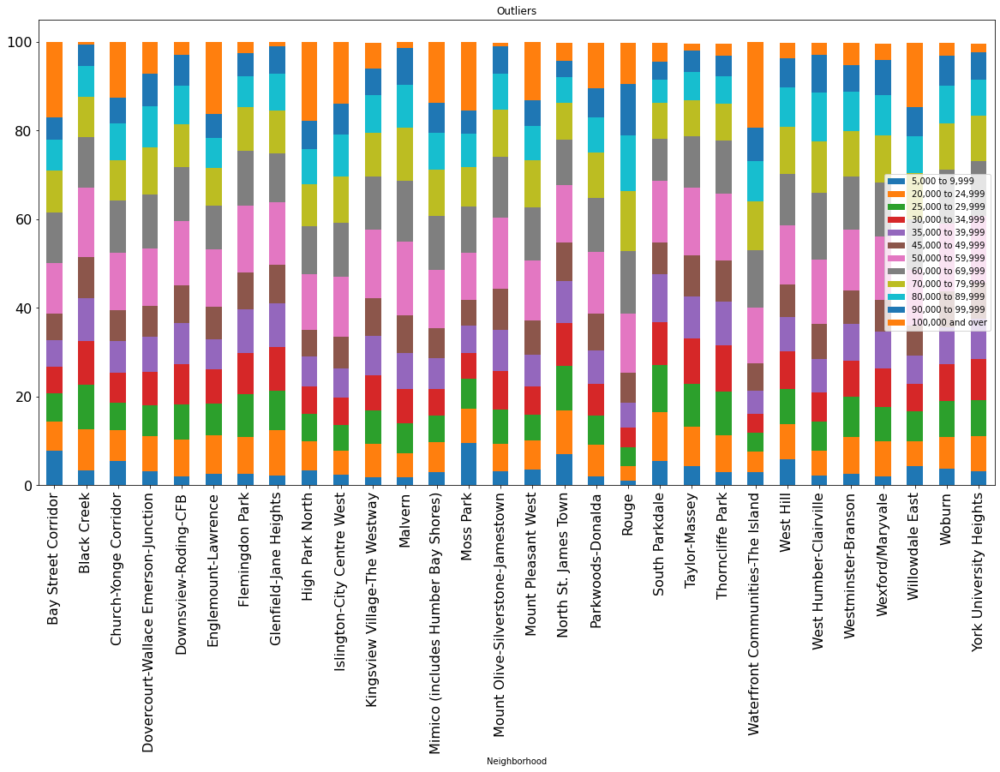

In [224]:
#outliers.reset_index(inplace=True)
df_plot=pd.DataFrame()
df_plot =percentify(outliers[['5,000 to 9,999', '20,000 to 24,999',
       '25,000 to 29,999', '30,000 to 34,999', '35,000 to 39,999',
       '45,000 to 49,999', '50,000 to 59,999', '60,000 to 69,999',
       '70,000 to 79,999', '80,000 to 89,999', '90,000 to 99,999',
       '100,000 and over']].copy())
df_plot.insert(0,'Neighborhood',outliers['Neighborhood'])
#df_plot = df_plot.groupby(df_plot.columns.to_list()).size().reset_index().drop([0],axis=1)
df_plot.plot(kind='bar', stacked=True,x='Neighborhood',figsize=(20,10),title="Outliers",fontsize='16',grid=False)
#df_plot

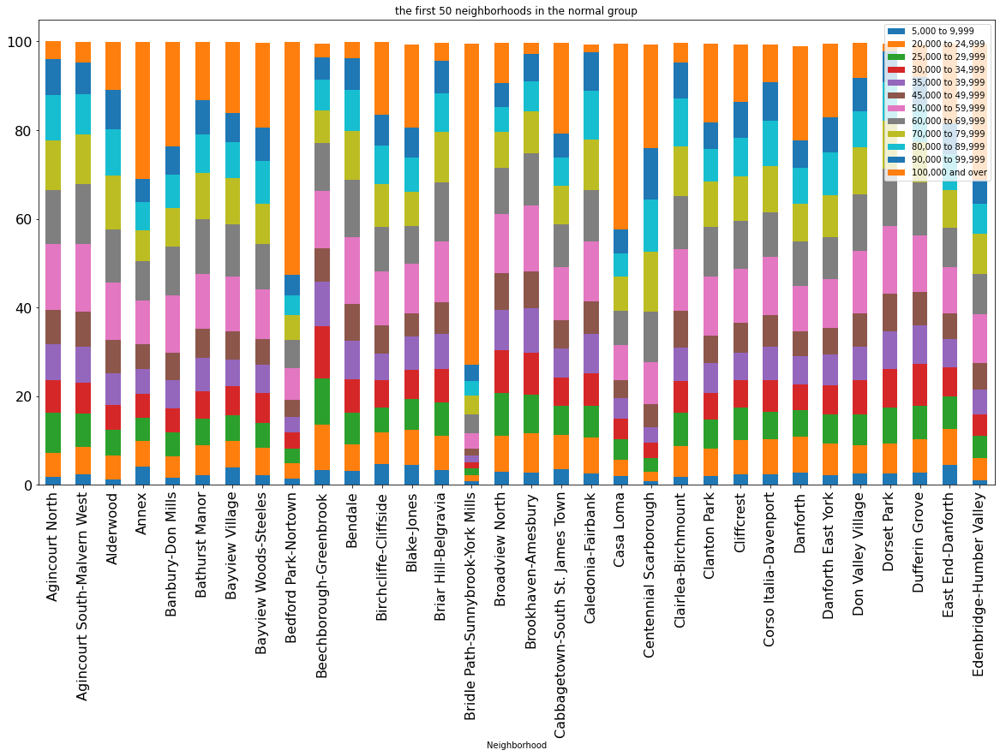

In [225]:
#outliers.reset_index(inplace=True)
df_plot=pd.DataFrame()
df_plot =percentify(new_df[['5,000 to 9,999', '20,000 to 24,999',
       '25,000 to 29,999', '30,000 to 34,999', '35,000 to 39,999',
       '45,000 to 49,999', '50,000 to 59,999', '60,000 to 69,999',
       '70,000 to 79,999', '80,000 to 89,999', '90,000 to 99,999',
       '100,000 and over']].copy())
df_plot.insert(0,'Neighborhood',new_df['Neighborhood'])
#df_plot = df_plot.groupby(df_plot.columns.to_list()).size().reset_index().drop([0],axis=1)
df_plot[:32].plot(kind='bar', stacked=True,x='Neighborhood',figsize=(20,10),title="the first 50 neighborhoods in the normal group",fontsize='16',grid=False)
#df_plot

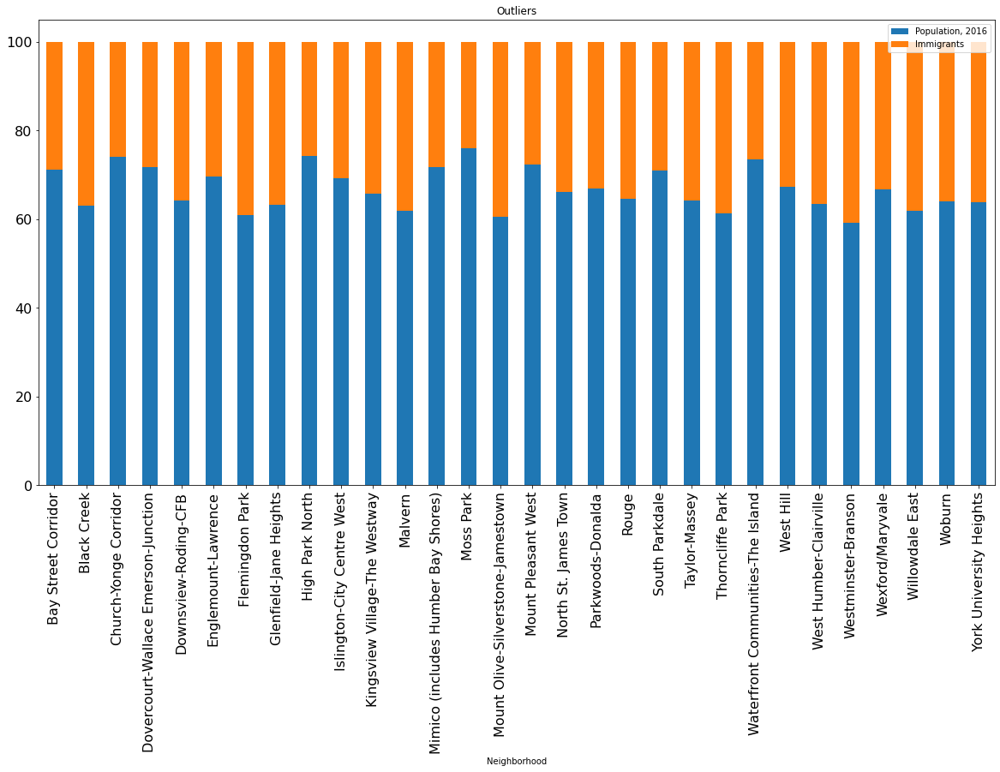

In [226]:
#outliers.reset_index(inplace=True)
df_plot=pd.DataFrame()
df_plot =percentify(outliers[['Population, 2016','Immigrants']].copy())
df_plot.insert(0,'Neighborhood',outliers['Neighborhood'])
#df_plot = df_plot.groupby(df_plot.columns.to_list()).size().reset_index().drop([0],axis=1)
df_plot.plot(kind='bar', stacked=True,x='Neighborhood',figsize=(20,10),title="Outliers",fontsize='16',grid=False)
#df_plot

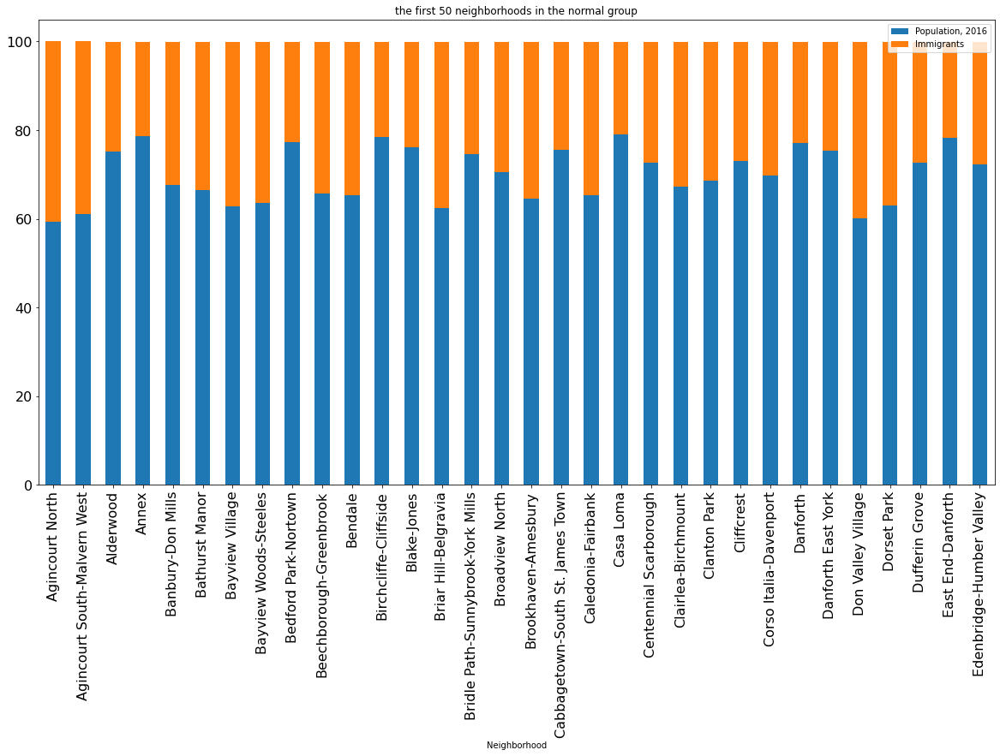

In [227]:
#outliers.reset_index(inplace=True)
df_plot=pd.DataFrame()
df_plot =percentify(new_df[['Population, 2016','Immigrants']].copy())
df_plot.insert(0,'Neighborhood',new_df['Neighborhood'])
#df_plot = df_plot.groupby(df_plot.columns.to_list()).size().reset_index().drop([0],axis=1)
df_plot[:32].plot(kind='bar', stacked=True,x='Neighborhood',figsize=(20,10),title="the first 50 neighborhoods in the normal group",fontsize='16',grid=False)
#df_plot

In [228]:
population[population['Neighborhood']=='Bridle Path-Sunnybrook-York Mills']

,Neighborhood,"Population, 2016","Population, 2011",Population Change 2011-2016,Total private dwellings,Private dwellings occupied by usual residents,Population density per square kilometre,Land area in square kilometres,Children (0-14 years),Youth (15-24 years),Working Age (25-54 years),Pre-retirement (55-64 years),Seniors (65+ years),Older Seniors (85+ years),Male: 0 to 04 years,Male: 05 to 09 years,Male: 10 to 14 years,Male: 15 to 19 years,Male: 20 to 24 years,Male: 25 to 29 years,Male: 30 to 34 years,Male: 35 to 39 years,Male: 40 to 44 years,Male: 45 to 49 years,Male: 50 to 54 years,Male: 55 to 59 years,Male: 60 to 64 years,Male: 65 to 69 years,Male: 70 to 74 years,Male: 75 to 79 years,Female: 10 to 14 years,Male: 80 to 84 years,Male: 85 to 89 years,Male: 90 to 94 years,Male: 95 to 99 years,Male: 100 years and over,Female: 0 to 04 years,Female: 05 to 09 years,Female: 15 to 19 years,Female: 20 to 24 years,Female: 25 to 29 years,Female: 30 to 34 years,Female: 35 to 39 years,Female: 40 to 44 years,Female: 45 to 49 years,Female: 50 to 54 years,Female: 55 to 59 years,Female: 60 to 64 years,Female: 65 to 69 years,Female: 70 to 74 years,Female: 75 to 79 years,Female: 80 to 84 years,Female: 85 to 89 years,Female: 90 to 94 years,Female: 95 to 99 years,Female: 100 years and over,Occupied private dwellings by structural type of dwelling,Single-detached house,Apartment in a building that has five or more storeys,Other attached dwelling,Semi-detached house,Row house,Apartment or flat in a duplex,Apartment in a building that has fewer than five storeys,Other single-attached house,Movable dwelling,Private households by household size,1 person,2 persons,3 persons,4 persons,5 or more persons,Number of persons in private households,Average household size,Marital status for the population aged 15 years and over,Married or living common law,Married,Living common law,Not married and not living common law,Never married,Separated,Divorced,Widowed,Census families in private households by family size,2 persons.1,3 persons.1,4 persons.1,5 or more persons.1,Couples without children,Total number of census families in private households,Total couple families,Married couples,Common-law couples,Total lone-parent families by sex of parent,Female parent,Male parent,Couple census families in private households,Couples with children,1 child,2 children,3 or more children,Lone-parent census families in private households,1 child.1,2 children.1,Non-census-family households,3 or more children.1,Persons not in census families in private households,Private households by household type,One-census-family households,Without children in a census family,With children in a census family,Multiple-census-family households,One-person households,Two-or-more person non-census-family households,Total population (age 15+) by family characteristics,Persons living alone (total),Persons living alone (per cent),Population age 65+ by family characteristics,Persons age 65+ living alone (total),Persons age 65+ living alone (per cent),Population age 85+ by family characteristics,Persons age 85+ living alone (total),Persons age 85+ living alone (per cent),Population age 20-34 by family characteristics,Single young adults (age 20-34) living at home (total),Single young adults (age 20-34) living at home (per cent),Knowledge of official languages for the total population excluding institutional residents,English only,French only,English and French,Neither English nor French,First official language spoken for the total population excluding institutional residents,English,Official language minority (percentage),French,English and French.1,Neither English nor French.1,Official language minority (number),Mother tongue for the total population excluding institutional residents,Single responses,Official languages,English.1,French.1,Non-official languages,Aboriginal languages,Algonquian languages,Blackfoot,Cree-Montagnais languages,Eastern Algonquian languages,Ojibway-Potawatomi languages,"Algo

In [229]:
population['Population density per square kilometre'].mean()

6261.135714285714

In [231]:
outliers_labeled=outliers.copy()
outliers_labeled['group']='Outlier'
#outliers_labeled.head()
normal_labeled=new_df.copy()
normal_labeled['group']='Normal'
#normal_labeled.head()
labeled_merged=pd.concat([outliers_labeled,normal_labeled])
labeled_merged.shape

(140, 2259)

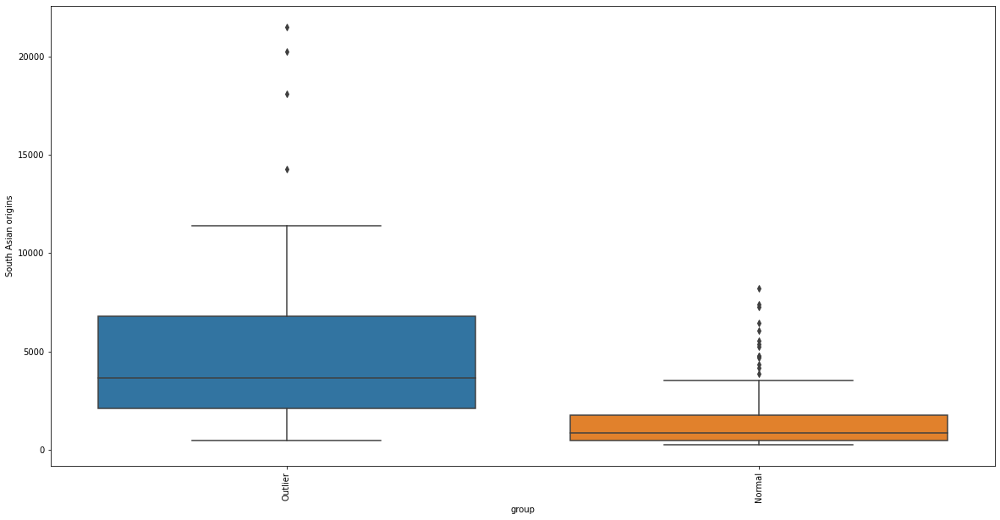

In [232]:
fig, ax = plt.subplots(figsize=(20,10))
plt.xticks(rotation=90)
ax = sns.boxplot(x="group", y="South Asian origins",data=labeled_merged)

In [233]:
print ("People of South Asian origin:")
print("outliers : "+str((outliers['South Asian origins'].sum()/outliers['Population, 2016'].sum())*100))
print("normal group : "+str((new_df['South Asian origins'].sum()/new_df['Population, 2016'].sum())*100))

People of South Asian origin:
outliers : 18.143280019804784
normal group : 9.995549571891207


### getting the lat long coordiantes of neighborhoods in outlier group

In [246]:
lat=[]
long=[]
neigh_=[]
for neigh in outliers['Neighborhood']:
    try:
        geolocator = Nominatim(user_agent="toronto_explorer")
        location = geolocator.geocode(neigh+', Toronto')
        latitude = location.latitude
        longitude = location.longitude
        lat.append(latitude)
        long.append(longitude)
        neigh_.append(neigh)
        #print('The geograpical coordinate of {} are {}, {}.'.format(neigh,latitude, longitude))
    except:
        lat.append('')
        long.append('')
        neigh_.append(neigh)
        print(neigh)


Downsview-Roding-CFB
Kingsview Village-The Westway
Mimico (includes Humber Bay Shores)
Mount Olive-Silverstone-Jamestown
Parkwoods-Donalda
Waterfront Communities-The Island
West Humber-Clairville
Westminster-Branson


There are 30 neighborhoods in outliers but Nominatim could not find GPS coordinates of 8 neighborhoods listed above.
I willadd manually.

In [248]:
lln = pd.DataFrame(list(zip(lat, long,neigh_)), columns =['lat', 'long','Neighborhood'])
lln.to_csv("latlong.csv")
print(outliers_pca.shape)
lln.shape

(30, 30)


(30, 3)

In [249]:
lln= pd.read_csv('latlong.csv')
pop_merged = lln.join(outliers.set_index('Neighborhood'), on='Neighborhood')

In [250]:
outliers=pop_merged.copy()
outliers=outliers.drop(['lat','long','Neighborhood'],axis=1)

In [251]:
#population.insert(0,"Neighborhoods",neighborhoods)
#population.set_index(population.columns[0])
t=outliers.corr().unstack().sort_values()

In [252]:
# high correlation between French Origins and Arts/Entertainment is an interesting bit
t.loc['French origins'].loc['71 Arts, entertainment and recreation']

0.937286748043049

In [253]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
outliers_scaled=scaler.fit_transform(outliers_pca)
outliers_scaled

array([[-3.13239642e-01,  1.00468643e+00,  1.00638992e+00,
        -1.45700710e+00,  7.76324378e-01,  8.28348183e-01,
         4.63713599e-01,  1.73556171e-01,  1.69063978e-01,
        -2.74749606e-01, -7.32388586e-01, -2.35677992e-01,
        -3.63122097e-01, -1.72692129e-02,  1.29593437e+00,
         1.52121642e+00, -8.38212803e-02, -3.55818468e-01,
        -6.95088945e-02,  3.10260837e-01, -5.46192275e-02,
        -1.57217599e+00, -1.56488084e+00,  1.61267033e+00,
        -1.21788449e+00, -1.31609131e+00,  6.48128621e-01,
         2.14229097e+00, -1.40776975e+00, -6.39567503e-02],
       [-9.28071507e-01, -1.02988621e+00, -1.26405114e+00,
        -2.94850238e-01,  3.87186010e-01,  1.69786772e+00,
         9.84482215e-01, -2.99948369e-01,  2.51177682e-01,
         1.79915112e+00, -8.34963305e-02, -3.01210754e-01,
        -1.31548305e-01, -1.51517675e+00, -1.86659314e+00,
         2.33867800e-01, -7.35473461e-01, -1.41283797e+00,
         1.45907261e+00,  9.36516050e-02,  2.09885888e-

1 : 5.413499103793663
2 : 5.177838362202449
3 : 5.031457445830185
4 : 4.736950498588894
5 : 4.715822199864117
6 : 4.410184197993421
7 : 4.296641004989826
8 : 4.046038496827159
9 : 3.974035887980037


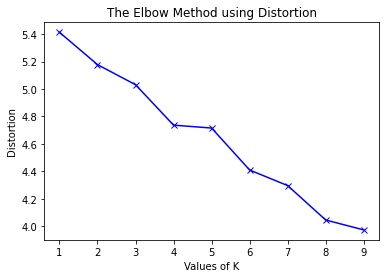

In [265]:
# k means determine k
from scipy.spatial.distance import cdist
X=outliers_scaled
distortions = [] 
inertias = [] 
mapping1 = {} 
mapping2 = {} 
K = range(1,10) 
for k in K: 
    #Building and fitting the model 
    kmeanModel = KMeans(n_clusters=k).fit(X) 
    kmeanModel.fit(X)     
      
    distortions.append(sum(np.min(cdist(X, kmeanModel.cluster_centers_, 
                      'euclidean'),axis=1)) / X.shape[0]) 
    inertias.append(kmeanModel.inertia_) 
  
    mapping1[k] = sum(np.min(cdist(X, kmeanModel.cluster_centers_, 
                 'euclidean'),axis=1)) / X.shape[0] 
    mapping2[k] = kmeanModel.inertia_ 

for key,val in mapping1.items(): 
    print(str(key)+' : '+str(val)) 

plt.plot(K, distortions, 'bx-') 
plt.xlabel('Values of K') 
plt.ylabel('Distortion') 
plt.title('The Elbow Method using Distortion') 
plt.show() 

In [279]:
# set number of clusters
kclusters = 4
#pop_cluster = population.drop('Characteristic', 1)
outliers_cluster=outliers_scaled

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(outliers_cluster)

# check cluster labels generated for each row in the dataframe
kmeans.labels_
outliers_pca.shape

(30, 30)

Text(0.5, 0, 'Immigrant population')

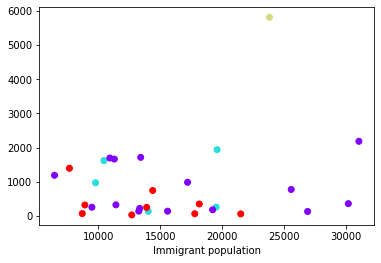

In [280]:
# add clustering labels
#pop_cluster.insert(0, 'Cluster Labels', kmeans.labels_)
#pop_cluster.insert(1, 'Neighborhood', population['Characteristic'])
#X=pop_cluster
plt.scatter(outliers['Immigrants'],outliers['100,000 and over'], c=kmeans.labels_, cmap='rainbow')
plt.xlabel("Immigrant population")
#plt.ylabel("2016 population")

In [281]:
# add clustering labels and other columns that were removed earlier
outliers.drop(['Cluster Labels'],axis=1, inplace=True)
outliers.drop(['lat'],axis=1, inplace=True)
outliers.drop(['long'],axis=1, inplace=True)
outliers.drop(['Neighborhood'],axis=1, inplace=True)

outliers.insert(0,'Neighborhood',pop_merged['Neighborhood'])
outliers.insert(1,'lat',pop_merged['lat'])
outliers.insert(2,'long',pop_merged['long'])

outliers.insert(1, 'Cluster Labels', kmeans.labels_)

In [284]:
 outliers[['Neighborhood','Cluster Labels']]

,Neighborhood,Cluster Labels
0,Bay Street Corridor,1
1,Black Creek,3
2,Church-Yonge Corridor,0
3,Dovercourt-Wallace Emerson-Junction,3
4,Downsview-Roding-CFB,1
5,Englemount-Lawrence,1
6,Flemingdon Park,1
7,Glenfield-Jane Heights,3
8,High Park North,3
9,Islington-City Centre West,1


In [340]:
#Downtown Toronto
map_toronto = folium.Map(location=[latitude, longitude], zoom_start=10, tiles='CartoDB dark_matter')

x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]


# add markers to map
for lat, lng, label,cluster in zip(outliers['lat'], outliers['long'], outliers['Neighborhood'],outliers['Cluster Labels']):
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=0.7).add_to(map_toronto),
map_toronto

CLIENT_ID = '3GJO4YU4IMCZ44FCOFEUNGQVZ5HYZG41OMWFIA50OOXK4F4N' # your Foursquare ID
CLIENT_SECRET = 'R4MFRRXYGUSXBOHAVUPPENSOS0EUPQ4VVMD3GRDHUHNBQXVM' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

In [310]:
LIMIT=100
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [311]:
toronto_venues = getNearbyVenues(names=outliers['Neighborhood'],
                                   latitudes=outliers['lat'],
                                   longitudes=outliers['long']
                                  )

Bay Street Corridor
Black Creek
Church-Yonge Corridor
Dovercourt-Wallace Emerson-Junction
Downsview-Roding-CFB
Englemount-Lawrence
Flemingdon Park
Glenfield-Jane Heights
High Park North
Islington-City Centre West
Kingsview Village-The Westway
Malvern
Mimico (includes Humber Bay Shores)
Moss Park
Mount Olive-Silverstone-Jamestown
Mount Pleasant West
North St. James Town
Parkwoods-Donalda
Rouge
South Parkdale
Taylor-Massey
Thorncliffe Park
Waterfront Communities-The Island
West Hill
West Humber-Clairville
Westminster-Branson
Wexford/Maryvale
Willowdale East
Woburn
York University Heights


In [312]:
print(toronto_venues.shape)
toronto_venues.head()

(661, 7)


,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Bay Street Corridor,43.667342,-79.388457,Indigo,43.669065,-79.389057,Bookstore
1,Bay Street Corridor,43.667342,-79.388457,DanceLifeX Centre,43.666956,-79.385297,Dance Studio
2,Bay Street Corridor,43.667342,-79.388457,Toronto Hemp Company,43.668419,-79.385848,Smoke Shop
3,Bay Street Corridor,43.667342,-79.388457,Tokyo Sushi,43.665885,-79.386977,Sushi Restaurant
4,Bay Street Corridor,43.667342,-79.388457,Bay Street Video,43.668890,-79.389247,Video Store


In [313]:
toronto_venues.groupby('Neighborhood').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
Bay Street Corridor,100,100,100,100,100,100
Black Creek,4,4,4,4,4,4
Church-Yonge Corridor,31,31,31,31,31,31
Dovercourt-Wallace Emerson-Junction,16,16,16,16,16,16
Downsview-Roding-CFB,2,2,2,2,2,2
Englemount-Lawrence,5,5,5,5,5,5
Flemingdon Park,15,15,15,15,15,15
Glenfield-Jane Heights,21,21,21,21,21,21
High Park North,7,7,7,7,7,7


In [314]:
print('{} venues from {} neighborhoods'.format(toronto_venues.shape[0],outliers.shape[0]))

661 venues from 30 neighborhoods


In [315]:
print('There are {} uniques categories.'.format(len(toronto_venues['Venue Category'].unique())))

There are 172 uniques categories.


In [316]:
# one hot encoding
toronto_onehot = pd.get_dummies(toronto_venues[['Venue Category']], prefix="", prefix_sep="")
# add neighborhood column back to dataframe
toronto_onehot['Neighborhood'] = toronto_venues['Neighborhood'] 

# move neighborhood column to the first column
fixed_columns = [toronto_onehot.columns[-1]] + list(toronto_onehot.columns[:-1])
toronto_onehot = toronto_onehot[fixed_columns]

toronto_onehot.head()

,Yoga Studio,Afghan Restaurant,American Restaurant,Aquarium,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Automotive Shop,BBQ Joint,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Stadium,Beach,Beer Bar,Beer Store,Big Box Store,Bistro,Bookstore,Boutique,Breakfast Spot,Brewery,Bubble Tea Shop,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Business Service,Café,Caribbean Restaurant,Chinese Restaurant,Chocolate Shop,Clothing Store,Cocktail Bar,Coffee Shop,College Theater,Comic Shop,Construction & Landscaping,Convenience Store,Convention Center,Cosmetics Shop,Creperie,Cupcake Shop,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distribution Center,Electronics Store,Ethiopian Restaurant,Event Space,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Food & Drink Shop,French Restaurant,Fried Chicken Joint,Furniture / Home Store,Gas Station,Gastropub,General Entertainment,German Restaurant,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Hardware Store,Health & Beauty Service,History Museum,Hobby Shop,Hotel,Hotel Bar,Housing Development,IT Services,Ice Cream Shop,Indian Restaurant,Intersection,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Karaoke Bar,Korean Restaurant,Lake,Laundromat,Library,Light Rail Station,Liquor Store,Lounge,Market,Martial Arts Dojo,Mattress Store,Medical Center,Mediterranean Restaurant,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Movie Theater,Moving Target,Music Venue,Neighborhood,New American Restaurant,Nightclub,Office,Pakistani Restaurant,Paper / Office Supplies Store,Park,Performing Arts Venue,Pet Store,Pharmacy,Pie Shop,Pizza Place,Playground,Plaza,Poke Place,Pool Hall,Portuguese Restaurant,Pub,Ramen Restaurant,Rental Car Location,Residential Building (Apartment / Condo),Restaurant,Roof Deck,Salad Place,Salon / Barbershop,Sandwich Place,Scenic Lookout,Science Museum,Sculpture Garden,Seafood Restaurant,Shopping Mall,Skating Rink,Smoke Shop,Smoothie Shop,Soccer Field,Spa,Sporting Goods Shop,Sports Bar,Steakhouse,Storage Facility,Supermarket,Sushi Restaurant,Taco Place,Tea Room,Tennis Court,Thai Restaurant,Theater,Thrift / Vintage Store,Toy / Game Store,Trail,Train Station,Turkish Restaurant,Vegetarian / Vegan Restaurant,Video Game Store,Video Store,Vietnamese Restaurant,Warehouse Store,Whisky Bar,Women's Store
0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Bay Street Corridor,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Bay Street Corridor,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Bay Street Corridor,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Bay Street Corridor,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

In [317]:
toronto_onehot.shape

(661, 172)

In [318]:
toronto_grouped = toronto_onehot.groupby('Neighborhood').mean().reset_index()
toronto_grouped

,Neighborhood,Yoga Studio,Afghan Restaurant,American Restaurant,Aquarium,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Automotive Shop,BBQ Joint,Bakery,Bank,Bar,Baseball Field,Baseball Stadium,Basketball Stadium,Beach,Beer Bar,Beer Store,Big Box Store,Bistro,Bookstore,Boutique,Breakfast Spot,Brewery,Bubble Tea Shop,Building,Burger Joint,Burrito Place,Bus Line,Bus Station,Bus Stop,Business Service,Café,Caribbean Restaurant,Chinese Restaurant,Chocolate Shop,Clothing Store,Cocktail Bar,Coffee Shop,College Theater,Comic Shop,Construction & Landscaping,Convenience Store,Convention Center,Cosmetics Shop,Creperie,Cupcake Shop,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Dim Sum Restaurant,Diner,Discount Store,Distribution Center,Electronics Store,Ethiopian Restaurant,Event Space,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant,Fish & Chips Shop,Food & Drink Shop,French Restaurant,Fried Chicken Joint,Furniture / Home Store,Gas Station,Gastropub,General Entertainment,German Restaurant,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Hardware Store,Health & Beauty Service,History Museum,Hobby Shop,Hotel,Hotel Bar,Housing Development,IT Services,Ice Cream Shop,Indian Restaurant,Intersection,Italian Restaurant,Japanese Restaurant,Jewelry Store,Juice Bar,Karaoke Bar,Korean Restaurant,Lake,Laundromat,Library,Light Rail Station,Liquor Store,Lounge,Market,Martial Arts Dojo,Mattress Store,Medical Center,Mediterranean Restaurant,Men's Store,Metro Station,Mexican Restaurant,Middle Eastern Restaurant,Miscellaneous Shop,Movie Theater,Moving Target,Music Venue,New American Restaurant,Nightclub,Office,Pakistani Restaurant,Paper / Office Supplies Store,Park,Performing Arts Venue,Pet Store,Pharmacy,Pie Shop,Pizza Place,Playground,Plaza,Poke Place,Pool Hall,Portuguese Restaurant,Pub,Ramen Restaurant,Rental Car Location,Residential Building (Apartment / Condo),Restaurant,Roof Deck,Salad Place,Salon / Barbershop,Sandwich Place,Scenic Lookout,Science Museum,Sculpture Garden,Seafood Restaurant,Shopping Mall,Skating Rink,Smoke Shop,Smoothie Shop,Soccer Field,Spa,Sporting Goods Shop,Sports Bar,Steakhouse,Storage Facility,Supermarket,Sushi Restaurant,Taco Place,Tea Room,Tennis Court,Thai Restaurant,Theater,Thrift / Vintage Store,Toy / Game Store,Trail,Train Station,Turkish Restaurant,Vegetarian / Vegan Restaurant,Video Game Store,Video Store,Vietnamese Restaurant,Warehouse Store,Whisky Bar,Women's Store
0,Bay Street Corridor,0.010000,0.000000,0.000000,0.00,0.01,0.01,0.000000,0.01,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.00,0.00,0.000000,0.010000,0.000000,0.000000,0.000000,0.01000,0.04,0.000000,0.00000,0.010000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.050000,0.010000,0.000000,0.01,0.050000,0.00,0.070000,0.01,0.01,0.00,0.000000,0.00,0.02,0.000000,0.000000,0.010000,0.000000,0.010000,0.010000,0.01,0.020000,0.000000,0.000000,0.0,0.010000,0.00,0.000000,0.000000,0.000000,0.00,0.010000,0.04,0.000000,0.010000,0.000000,0.00,0.010000,0.00,0.00,0.02000,0.000000,0.000000,0.010000,0.010000,0.000000,0.01,0.00,0.000000,0.010000,0.00,0.000000,0.00,0.00,0.020000,0.000000,0.040000,0.040000,0.01,0.010000,0.00,0.00,0.000000,0.000000,0.000000,0.000000,0.010000,0.01,0.000000,0.010000,0.000000,0.000000,0.03,0.01,0.000000,0.010000,0.010000,0.0,0.000000,0.0,0.00,0.00,0.010000,0.01,0.000000,0.000000,0.020000,0.00,0.0,0.000000,0.000000,0.020000,0.00,0.00,0.00,0.000000,0.0000,0.00,0.010000,0.000000,0.00000,0.020000,0.00,0.01,0.000000,0.020000,0.00,0.000000,0.000000,0.00000,0.010000,0.000000,0.02,0.000000,0.000000,0.01,0.00,0.000000,0.000000,0.000000,0.000000,0.040000,0.00000,0.00,0.000000,0.01,0.00,0.000000,0.000000,0.000000,0.00,0.000000,0.01000,0.000000,0.01,0.000000,0.000000,0.00,0.020000
1,Black Creek,0.000000,0.000000,0.000000,0.00,0.00,0.00,0.000000,0.00,0.000000,0.00,0.000000,0.000000,0.000000,0.000000,0.00,0.00,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.00,0.000000,0.000

In [319]:
toronto_grouped.shape

(30, 172)

In [320]:
num_top_venues = 5

for hood in toronto_grouped['Neighborhood']:
    print("----"+hood+"----")
    temp = toronto_grouped[toronto_grouped['Neighborhood'] == hood].T.reset_index()
    temp.columns = ['venue','freq']
    temp = temp.iloc[1:]
    temp['freq'] = temp['freq'].astype(float)
    temp = temp.round({'freq': 2})
    print(temp.sort_values('freq', ascending=False).reset_index(drop=True).head(num_top_venues))
    print('\n')

----Bay Street Corridor----
                venue  freq
0         Coffee Shop  0.07
1                Café  0.05
2      Clothing Store  0.05
3  Italian Restaurant  0.04
4   French Restaurant  0.04


----Black Creek----
                        venue  freq
0  Construction & Landscaping  0.50
1                 Coffee Shop  0.25
2                  Playground  0.25
3                 Yoga Studio  0.00
4                        Park  0.00


----Church-Yonge Corridor----
                 venue  freq
0          Coffee Shop  0.23
1                 Park  0.06
2                Diner  0.06
3          Yoga Studio  0.03
4  Distribution Center  0.03


----Dovercourt-Wallace Emerson-Junction----
                venue  freq
0         Coffee Shop  0.19
1                Café  0.19
2  Italian Restaurant  0.06
3       Grocery Store  0.06
4               Diner  0.06


----Downsview-Roding-CFB----
                           venue  freq
0                           Park   0.5
1              Electronics Store   0.

In [321]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [322]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['Neighborhood'] = toronto_grouped['Neighborhood']

for ind in np.arange(toronto_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(toronto_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,Bay Street Corridor,Coffee Shop,Clothing Store,Café,French Restaurant,Japanese Restaurant,Italian Restaurant,Boutique,Sushi Restaurant,Mediterranean Restaurant,Park
1,Black Creek,Construction & Landscaping,Playground,Coffee Shop,Diner,Fast Food Restaurant,Falafel Restaurant,Event Space,Ethiopian Restaurant,Electronics Store,Distribution Center
2,Church-Yonge Corridor,Coffee Shop,Diner,Park,Dance Studio,Burger Joint,Sculpture Garden,Burrito Place,Ramen Restaurant,Creperie,Yoga Studio
3,Dovercourt-Wallace Emerson-Junction,Coffee Shop,Café,Brewery,Pharmacy,Skating Rink,Portuguese Restaurant,Italian Restaurant,Grocery Store,Park,Discount Store
4,Downsview-Roding-CFB,Electronics Store,Park,Women's Store,Dim Sum Restaurant,Fast Food Restaurant,Falafel Restaurant,Event Space,Ethiopian Restaurant,Distribution Center,Discount Store


1 : 0.35378829198713896
2 : 0.3198956294237278
3 : 0.2909325779394026
4 : 0.27419177046520127
5 : 0.2560520326087267
6 : 0.23906376378628594
7 : 0.21504577137899197
8 : 0.19718992926373297
9 : 0.17967683673586785


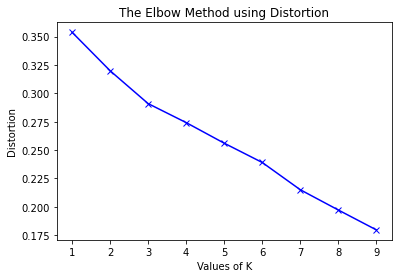

In [327]:
X=toronto_grouped.drop('Neighborhood', 1)
distortions = [] 
inertias = [] 
mapping1 = {} 
mapping2 = {} 
K = range(1,10) 
for k in K: 
    #Building and fitting the model 
    kmeanModel = KMeans(n_clusters=k).fit(X) 
    kmeanModel.fit(X)     
      
    distortions.append(sum(np.min(cdist(X, kmeanModel.cluster_centers_, 
                      'euclidean'),axis=1)) / X.shape[0]) 
    inertias.append(kmeanModel.inertia_) 
  
    mapping1[k] = sum(np.min(cdist(X, kmeanModel.cluster_centers_, 
                 'euclidean'),axis=1)) / X.shape[0] 
    mapping2[k] = kmeanModel.inertia_ 

for key,val in mapping1.items(): 
    print(str(key)+' : '+str(val)) 

plt.plot(K, distortions, 'bx-') 
plt.xlabel('Values of K') 
plt.ylabel('Distortion') 
plt.title('The Elbow Method using Distortion') 
plt.show() 

In [333]:
# set number of clusters
kclusters = 4

toronto_grouped_clustering = toronto_grouped.drop('Neighborhood', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(toronto_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10] 

# add clustering labels
neighborhoods_venues_sorted.drop(['Cluster Labels'],inplace=True,axis=1)
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

toronto_merged = pop_merged.copy()

# merge toronto_grouped with toronto_data to add latitude/longitude for each neighborhood
toronto_merged = toronto_merged.join(neighborhoods_venues_sorted.set_index('Neighborhood'), on='Neighborhood')

toronto_merged.head() # check the last columns!

# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=10,  tiles='CartoDB dark_matter')

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

# add markers to the map
markers_colors = []
for lat, lon, poi, cluster in zip(toronto_merged['lat'], toronto_merged['long'], toronto_merged['Neighborhood'], toronto_merged['Cluster Labels']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[cluster-1],
        fill=True,
        fill_color=rainbow[cluster-1],
        fill_opacity=1).add_to(map_clusters)
       
map_clusters

In [334]:
toronto_merged.loc[toronto_merged['Cluster Labels'] == 2, toronto_merged.columns[[2] + list(range(5, toronto_merged.shape[1]))]]

long  Population, 2011  Population Change 2011-2016  \
4  -79.676804           34659.0                          1.1   
5  -79.437072           22086.0                          1.3   
8  -79.470961           21292.0                          4.1   
18 -79.165837           45912.0                          1.3   
19 -79.466584           21251.0                          2.8   

    Total private dwellings  Private dwellings occupied by usual residents  \
4                   14244.0                                        13121.0   
5                    8858.0                                         8247.0   
8                   11541.0                                        11023.0   
18                  13730.0                                        13389.0   
19                  12085.0                                        11390.0   

    Population density per square kilometre  Land area in square kilometres  \
4                                    2337.0                           15.00   
5                                    6466.0                            3.46   
8                                   11726.0                            1.89   
18                                   1260.0                           36.89   
19                                   9583.0                            2.28   

    Children (0-14 years)  Youth (15-24 years)  Working Age (25-54 years)  \
4                  5725.0               4340.0                    15045.0   
5                  4805.0               3030.0                     8385.0   
8                  2850.0               1890.0                    11660.0   
18                 7960.0               6700.0                    18510.0   
19                 2115.0               2275.0                    12440.0   

    Pre-retirement (55-64 years)  Seniors (65+ years)  \
4                         4380.0               5535.0   
5                         2430.0               3725.0   
8                         2585.0               3180.0   
18                        6690.0               6625.0   
19                        2475.0               2540.0   

    Older Seniors (85+ years)  Male: 0 to 04 years  Male: 05 to 09 years  \
4                       870.0                955.0                1015.0   
5                       955.0                785.0                 790.0   
8                       550.0                535.0                 505.0   
18                      685.0               1200.0                1445.0   
19                      360.0                455.0                 325.0   

    Male: 10 to 14 years  Male: 15 to 19 years  Male: 20 to 24 years  \
4                  945.0                1020.0                1185.0   
5                  770.0                 810.0                 720.0   
8                  395.0                 375.0                 495.0   
18                1405.0                1665.0                1825.0   
19                 330.0                 360.0                 705.0   

    Male: 25 to 29 years  Male: 30 to 34 years  Male: 35 to 39 years  \
4                 1115.0                1130.0                1195.0   
5                  605.0                 600.0                 635.0   
8                 1065.0                1215.0                 980.0   
18                1565.0                1420.0                1315.0   
19                1400.0                1475.0                1045.0   

    Male: 40 to 44 years  Male: 45 to 49 years  Male: 50 to 54 years  \
4                 1065.0                1185.0                1400.0   
5                  550.0                 565.0                 585.0   
8                  845.0                 755.0                 715.0   
18                1275.0                1445.0                1695.0   
19                 850.0                 810.0                 780.0   

    Male: 55 to 59 years  Male: 60 to 64 years  Male: 65 to 69 years  \
4                 1215.0                 925.0

In [338]:
 outliers[['Neighborhood','Cluster Labels']].sort_values(by='Cluster Labels')

,Neighborhood,Cluster Labels
29,York University Heights,0
27,Willowdale East,0
2,Church-Yonge Corridor,0
24,West Humber-Clairville,0
23,West Hill,0
21,Thorncliffe Park,0
18,Rouge,0
17,Parkwoods-Donalda,0
16,North St. James Town,0
15,Mount Pleasant West,0


In [339]:
toronto_merged[['Neighborhood','Cluster Labels']].sort_values(by='Cluster Labels')

,Neighborhood,Cluster Labels
0,Bay Street Corridor,0
1,Black Creek,0
2,Church-Yonge Corridor,0
3,Dovercourt-Wallace Emerson-Junction,0
27,Willowdale East,0
16,North St. James Town,0
6,Flemingdon Park,0
25,Westminster-Branson,0
15,Mount Pleasant West,0
17,Parkwoods-Donalda,0


In [402]:
compare_clusters=pd.DataFrame()
compare_clusters[['Neighborhood','Cluster_census']]=outliers[['Neighborhood','Cluster Labels']].copy()
compare_clusters[['Cluster_venues']]=toronto_merged[['Cluster Labels']].copy()
compare_clusters

,Neighborhood,Cluster_census,Cluster_venues
0,Bay Street Corridor,1,0
1,Black Creek,3,0
2,Church-Yonge Corridor,0,0
3,Dovercourt-Wallace Emerson-Junction,3,0
4,Downsview-Roding-CFB,1,2
5,Englemount-Lawrence,1,2
6,Flemingdon Park,1,0
7,Glenfield-Jane Heights,3,1
8,High Park North,3,2
9,Islington-City Centre West,1,1


In [361]:
tau, p_value = stats.kendalltau(outliers['Cluster Labels'],toronto_merged['Cluster Labels'])
print('tau:{}, p-value:{}'.format(tau,p_value))

tau:0.2535211267605633, p-value:0.12559254742606987


Kendall's tau for the two set of cluster labels shows a value close to zero indicating the two are different. But this is not the correct way to compare the two since they came from different data sets. Therefore, I need to standardize the ranks(labels) first.